# Segmentation algorithm using fastai

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from pyclouds.imports import *

In [3]:
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [4]:
# Necessary for some reason!?
get_ipython().config.get('IPKernelApp', {})['parent_appname'] = ""

In [5]:
from fastai.vision import *
from fastai.callbacks.hooks import *

In [6]:
IMGDIR = '/local/S.Rasp/cloud-classification/'

In [7]:
img_size = np.array((1400, 2100)) # Pytorch convention

In [8]:
work_size = img_size // 3; work_size

array([466, 700])

In [9]:
batch_size = 6

In [10]:
classes_bg = ['Background'] + classes

In [11]:
cl2id = {c: i for i, c in enumerate(classes_bg)}

## Load datasets

In [12]:
df = pd.read_csv(IMGDIR + 'fastai.csv', index_col=0); df.head()

,fn,mask
0,Region1_MAM_Aqua/Aqua_CorrectedReflectance2007...,masks/Region1_MAM_Aqua/Aqua_CorrectedReflectan...
1,Region3_DJF_Aqua/Aqua_CorrectedReflectance2015...,masks/Region3_DJF_Aqua/Aqua_CorrectedReflectan...
2,Region3_SON_Terra/Terra_CorrectedReflectance20...,masks/Region3_SON_Terra/Terra_CorrectedReflect...
3,Region1_DJF_Aqua/Aqua_CorrectedReflectance2011...,masks/Region1_DJF_Aqua/Aqua_CorrectedReflectan...
4,Region1_DJF_Aqua/Aqua_CorrectedReflectance2011...,masks/Region1_DJF_Aqua/Aqua_CorrectedReflectan...


In [13]:
len(df)

30236

In [14]:
# For fast ai the masks column needs absolute paths. Let's add them
df['mask'] = df['mask'].apply(lambda fn: IMGDIR + fn); df.head()

,fn,mask
0,Region1_MAM_Aqua/Aqua_CorrectedReflectance2007...,/local/S.Rasp/cloud-classification/masks/Regio...
1,Region3_DJF_Aqua/Aqua_CorrectedReflectance2015...,/local/S.Rasp/cloud-classification/masks/Regio...
2,Region3_SON_Terra/Terra_CorrectedReflectance20...,/local/S.Rasp/cloud-classification/masks/Regio...
3,Region1_DJF_Aqua/Aqua_CorrectedReflectance2011...,/local/S.Rasp/cloud-classification/masks/Regio...
4,Region1_DJF_Aqua/Aqua_CorrectedReflectance2011...,/local/S.Rasp/cloud-classification/masks/Regio...


In [15]:
# Create the fastai dataset
src = SegmentationItemList.from_df(df, path=IMGDIR); src

SegmentationItemList (30236 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification

In [16]:
# Split by Region
src = src.split_by_valid_func(lambda fn: 'Region2' in fn); src

ItemLists;

Train: SegmentationItemList (24206 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Valid: SegmentationItemList (6030 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Test: None

In [17]:
src = src.label_from_df('mask', classes=classes_bg); src

LabelLists;

Train: LabelList
y: SegmentationLabelList (24206 items)
[ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification
x: SegmentationItemList (24206 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Valid: LabelList
y: SegmentationLabelList (6030 items)
[ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification
x: SegmentationItemList (6030 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Test: None

In [18]:
data = src.transform(get_transforms(), size=work_size, tfm_y=True); data

LabelLists;

Train: LabelList
y: SegmentationLabelList (24206 items)
[ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification
x: SegmentationItemList (24206 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Valid: LabelList
y: SegmentationLabelList (6030 items)
[ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification
x: SegmentationItemList (6030 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Test: None

In [19]:
data = data.databunch(bs=batch_size)

In [20]:
data = data.normalize(imagenet_stats)

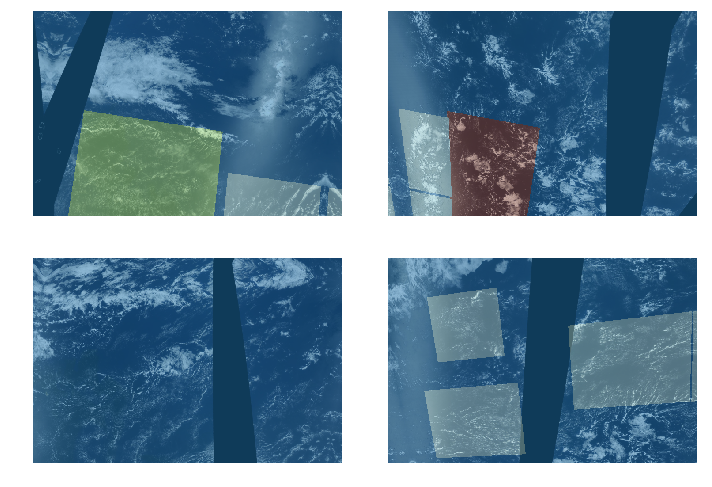

In [21]:
data.show_batch(2, figsize=(10,7))

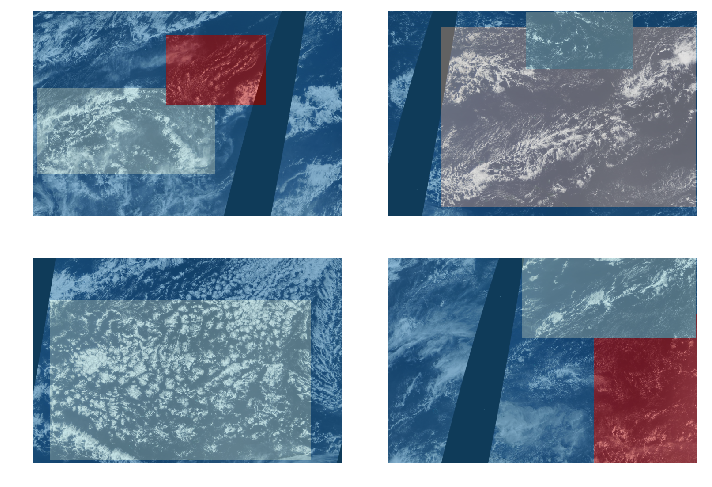

In [22]:
data.show_batch(2, figsize=(10,7), ds_type=DatasetType.Valid)

In [23]:
x, y = next(iter(data.valid_dl))

In [24]:
x.size(), y.size()

(torch.Size([6, 3, 466, 700]), torch.Size([6, 1, 466, 700]))

## Build the model

In [25]:
void_code = cl2id['Background']; void_code

0

In [26]:
# Define accuracy metric
def pixel_acc(input, target):
    target = target.squeeze(1)
    mask = target != void_code
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

In [27]:
wd=1e-2 

In [28]:
# use a small resnet as backbone with pretrained imagenet weights
learn = unet_learner(data, models.resnet18, metrics=pixel_acc, wd=wd, pretrained=True)

In [33]:
learn.loss_func 

FlattenedLoss of CrossEntropyLoss()

## Train the model

In [ ]:
lr_find(learn)
learn.recorder.plot()

In [ ]:
lr = 1e-4

In [ ]:
learn.fit_one_cycle(1, max_lr=lr, wd=wd)

## Load a trained model

In [29]:
learn.load('full_third_ep2')

Learner(data=ImageDataBunch;

Train: LabelList
y: SegmentationLabelList (24206 items)
[ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification
x: SegmentationItemList (24206 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Valid: LabelList
y: SegmentationLabelList (6030 items)
[ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100), ImageSegment (1, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification
x: SegmentationItemList (6030 items)
[Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100), Image (3, 1400, 2100)]...
Path: /local/S.Rasp/cloud-classification;

Test: None, model=DynamicUnet(
  (layers): ModuleList(
    (0): Sequen

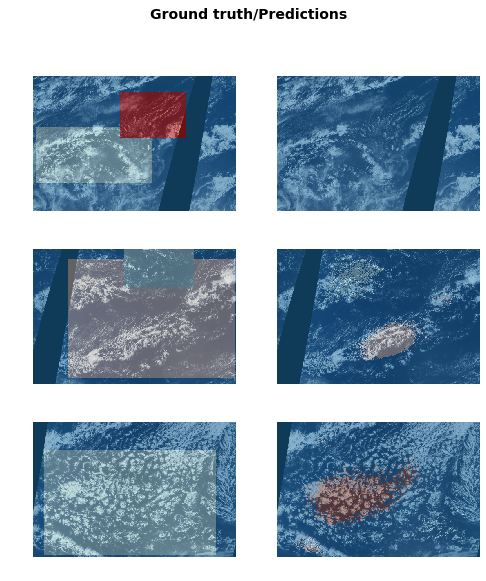

In [35]:
learn.show_results(rows=3, figsize=(8,9))

## Get model predictions

In [30]:
from scipy.ndimage import gaussian_filter

In [31]:
def get_pred(img):
    pred = learn.predict(img)[2]
    return pred.numpy()

In [32]:
def plot_probs(pred):
    fig, axs = plt.subplots(2, 3, figsize=(15, 10))
    for i, ax in enumerate(axs.flatten()[:5]):
        ax.matshow(pred[i], vmin=0, vmax=1)
        ax.set_title(classes_bg[i])
    plt.tight_layout()

In [33]:
def get_max_class(p, thresh=0.3, smooth=None):
    x = p.copy()
    if smooth is not None:
        for i in range(x.shape[0]):
            x[i] = gaussian_filter(x[i], smooth)
    x[0][np.max(x[1:], 0) > thresh] = 0
    return np.argmax(x, 0)

In [41]:
def plot_mask_over_img(img, mask):
    fig = plt.figure(figsize=(10,10))
    plt.imshow(np.rollaxis(img.data.numpy(), 0,3))
    plt.imshow(mask, alpha=0.2)

In [34]:
img, mask = data.valid_ds[8]

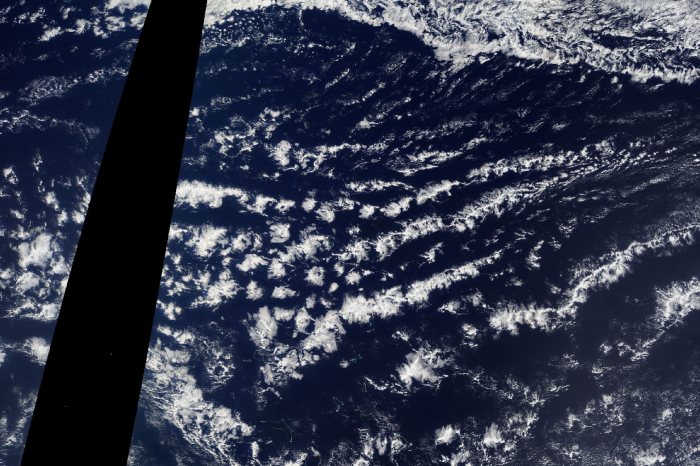

In [64]:
img

In [65]:
img.size

torch.Size([466, 700])

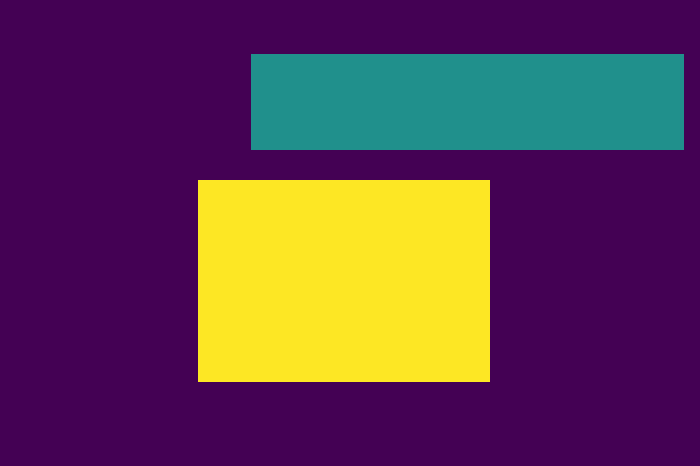

In [66]:
mask

In [67]:
np.unique(mask.data)

array([0, 1, 2])

In [68]:
pred = get_pred(img)

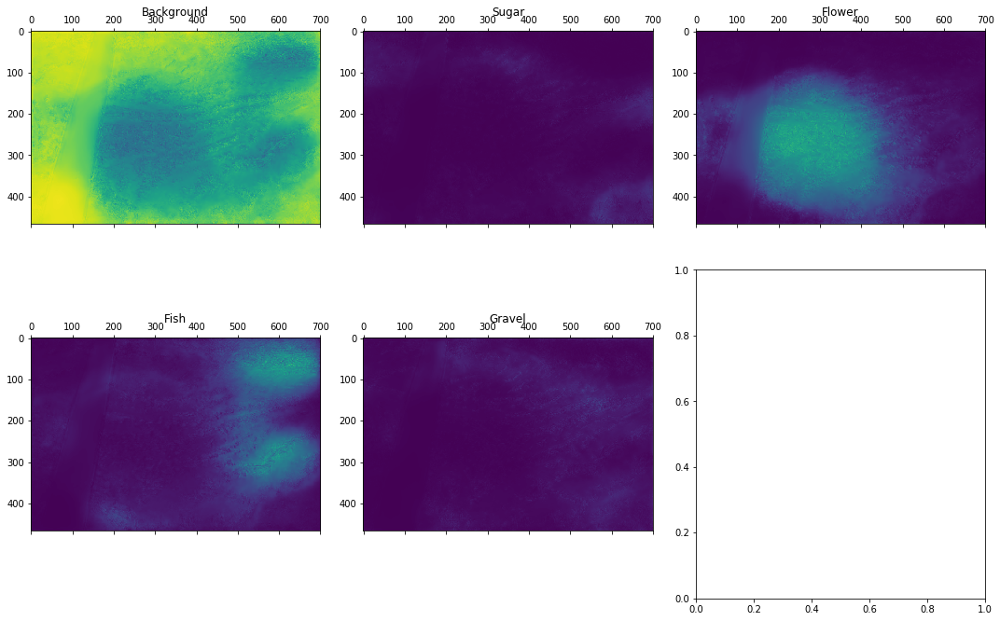

In [69]:
plot_probs(pred)

In [70]:
pred_mask = get_max_class(pred, 0.3, 10)

In [71]:
np.unique(pred_mask)

array([0, 2, 3])

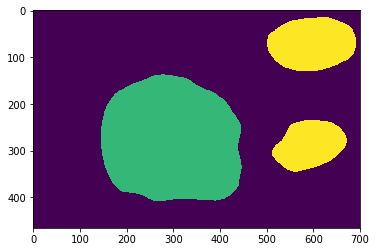

In [72]:
plt.imshow(pred_mask)

## Try to read world data

```
python image_download.py --year_range [2017,2018] --months [1,2,3,4,5,6,7,8,9,10,11,12] --lon_range [-180,180] --lat_range [-90,0] --save_path /project/meteo/work/S.Rasp/cloud-classification/world/ --satellite Aqua --deg2pix 50

python image_download.py --year_range [2017,2018] --months [1,2,3,4,5,6,7,8,9,10,11,12] --lon_range [-180,180] --lat_range [0,90] --save_path /project/meteo/work/S.Rasp/cloud-classification/world/ --satellite Aqua --deg2pix 50

convert /project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170101_-180-180_0-90.jpeg /project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170101_-180-180_-90-0.jpeg -append /project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170101_-180-180_-90-90.jpeg 
```

In [379]:
from glob import glob

In [416]:
world_fns = sorted(glob('/project/meteo/work/S.Rasp/cloud-classification/world/*_0-90*'))

In [417]:
world_fns

['/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170101_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170102_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170103_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170104_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170105_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170106_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170107_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170108_-180-180_0-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170109_-180-180_0-90.jpeg',
 

In [418]:
len(world_fns)

178

In [419]:
for fn in tqdm(world_fns):
    fn2 = fn[:-9] + '-90-0.jpeg'
    fn_out = fn[:-9] + '-90-90.jpeg'
    !convert $fn $fn2 -append $fn_out

^C
^C
^C
^C


Exception ignored in: <function _releaseLock at 0x7fedbea559d8>
Traceback (most recent call last):
  File "/home/s/S.Rasp/miniconda3/envs/fastai/lib/python3.7/logging/__init__.py", line 221, in _releaseLock
    def _releaseLock():
KeyboardInterrupt


UnboundLocalError: local variable 'child' referenced before assignment

In [424]:
world_fns = sorted(glob('/project/meteo/work/S.Rasp/cloud-classification/world/*_-90-90*'))

In [425]:
world_fns

['/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170101_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170102_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170103_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170104_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170105_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170106_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170107_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170108_-180-180_-90-90.jpeg',
 '/project/meteo/work/S.Rasp/cloud-classification/world/Aqua_CorrectedReflectance20170109_-180-1

In [410]:
def get_preds_from_fn(fn, learn, deg2pix, dx = 466, dy = 700):
    img = open_image(fn)
    raw_img_size = np.array(img.size)
    print(f'raw_img_size = {raw_img_size}')
    world_size = (np.array(raw_img_size) // 3 * (100 / deg2pix)).astype(int)
    print(f'world_size = {world_size}')
    img = img.apply_tfms(
        [RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)]*2, 
        size = world_size
    )
    
    nx = world_size[0] // dx
    ny = world_size[1] // dy
    print(f'nx, ny = {nx, ny}')
    
    raw_img = deepcopy(img)
    raw_px = img._px
    raw_px = raw_px[:, :nx*dx, :ny*dy]
    
    tot_pred = np.zeros([5, nx*dx, ny*dy])
    tot_pred[0] = 1
    
    for i in tqdm(np.arange(0, nx*dx, dx//2)[:-1]):
        for j in np.arange(0, ny*dy, dy//2)[:-1]:
            img._px = raw_px[:, i:i+dx, j:j+dy]
            pred = get_pred(img)

            lowest_bg = pred[0] < tot_pred[0, i:i+dx, j:j+dy]

            for ic in range(len(classes_bg)):
                tot_pred[ic, i:i+dx, j:j+dy] = np.where(lowest_bg, pred[ic], tot_pred[ic, i:i+dx, j:j+dy])
    
    img._px = raw_px
    
    return tot_pred, img

In [391]:
tot_pred, img = get_preds_from_fn(world_fns[0], learn, 50
)

raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


In [406]:
pred_mask = get_max_class(tot_pred, 0.3, 10)

In [404]:
def plot_mask_over_img(img, mask, z=1, save=None, contour=False):
    fig, ax = plt.subplots(1, 1, figsize=(25,25))
    
    img_data = np.rollaxis(img.data.numpy(), 0,3)
    orig_shape = np.array(pred_mask.shape)
    img_re = zoom(img_data, (z, z, 1)) if z !=0 else img_data
    mask_re = zoom(mask, (z, z)) if z !=0 else mask
    ax.imshow(img_re)
    ax.set_xticks([]); ax.set_yticks([])
    for i, c in enumerate(classes):
        a = mask_re == i+1
        if contour:
            ax.contour(a, levels=[0.5], colors=[np.array(l2c[c]) / 255], linewidths=[5])
        else:
            plt.imshow(a, alpha=0.5, cmap = mpl.colors.ListedColormap(['none', np.array(l2c[c]) / 255]))
        
    if save is not None:
        fig.savefig(save, bbox_inches='tight', pad_inches=0., dpi=200)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


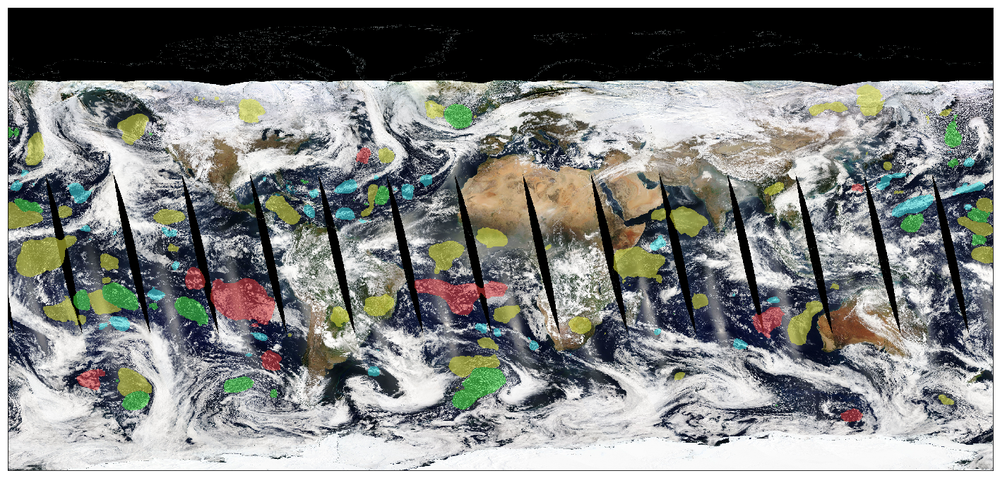

In [407]:
plot_mask_over_img(img, pred_mask, 0.3, '/project/meteo/work/S.Rasp/cloud-classification/ml/world_0.png')

In [422]:
len(world_fns)

114

In [ ]:
for fn in tqdm(world_fns):
    date = fn[-29:-21]
    tot_pred, img = get_preds_from_fn(fn, learn, 50)
    pred_mask = get_max_class(tot_pred, 0.3, 10)
    plot_mask_over_img(img, pred_mask, 0.3, f'/project/meteo/work/S.Rasp/cloud-classification/ml/world_{date}.png')
    np.save(f'/project/meteo/work/S.Rasp/cloud-classification/ml/world_prob_{date}.npy', tot_pred)
    np.save(f'/project/meteo/work/S.Rasp/cloud-classification/ml/world_mask_{date}.npy', pred_mask)

raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


raw_img_size = [ 9000 18000]
world_size = [ 6000 12000]
nx, ny = (12, 17)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


In [227]:
img = open_image(world_fns[1])

In [292]:
np.array(img.size)

array([ 5592, 11900])

In [229]:
world_size = np.array((img.shape[1:])).astype(int) // 3 * 2  # *2 because deg2pix=50
world_size

array([ 6000, 12000])

In [230]:
(3, *world_size)

(3, 6000, 12000)

In [231]:
img = img.apply_tfms([RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)]*2, 
    size = world_size)

In [232]:
img.size

torch.Size([6000, 12000])

In [233]:
raw_img = deepcopy(img)

In [234]:
dx = 466; dy = 700

In [235]:
nx = world_size[0] // dx
ny = world_size[1] // dy
nx, ny

(12, 17)

In [236]:
raw_px = img._px

In [237]:
img._px = raw_px[:, :466, :700]

In [ ]:
raw_img

In [ ]:
img

In [108]:
pred = get_pred(img)

In [148]:
raw_px = raw_px[:, :nx*dx, :ny*dy]

In [149]:
raw_px.shape

torch.Size([3, 2330, 2100])

In [177]:
tot_pred = np.zeros((5, 2330, 2100))

In [178]:
tot_pred[0] = 1

In [180]:
for i in np.arange(0, nx*dx, dx//2)[:-1]:
    for j in np.arange(0, ny*dy, dy//2)[:-1]:
        img._px = raw_px[:, i:i+dx, j:j+dy]
        pred = get_pred(img)
        
        lowest_bg = pred[0] < tot_pred[0, i:i+dx, j:j+dy]
        
        for ic in range(len(classes_bg)):
            tot_pred[ic, i:i+dx, j:j+dy] = np.where(lowest_bg, pred[ic], tot_pred[ic, i:i+dx, j:j+dy])

In [151]:
# for i in range(nx):
#     for j in range(ny):
#         img._px = raw_px[:, i*dx:(i+1)*dx, j*dy:(j+1)*dy]
#         tot_pred[:, i*dx:(i+1)*dx, j*dy:(j+1)*dy]

In [181]:
img._px = raw_px

In [152]:
pred.shape

(5, 466, 700)

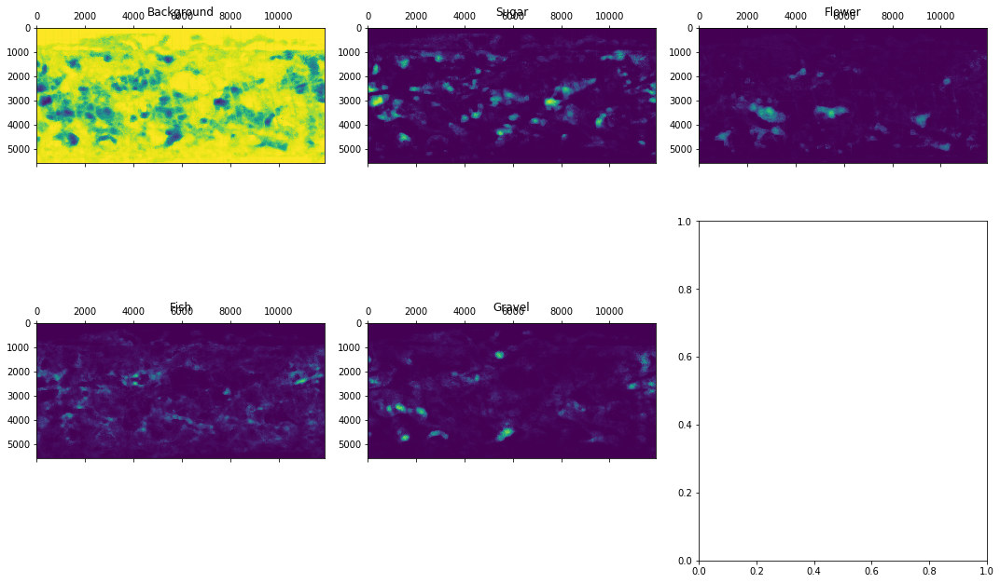

In [251]:
plot_probs(tot_pred)

In [286]:
pred_mask = get_max_class(tot_pred, 0.4, 15)

In [287]:
np.unique(pred_mask)

array([0, 1, 2, 3, 4])

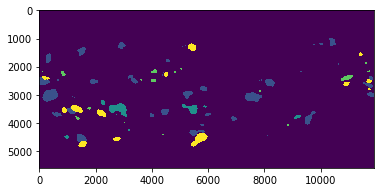

In [288]:
plt.imshow(pred_mask)

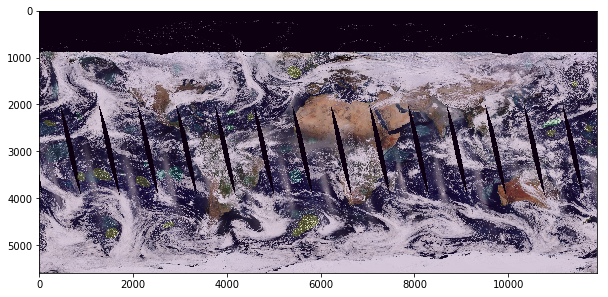

In [254]:
plot_mask_over_img(img, pred_mask)

In [255]:
img.shape

torch.Size([3, 5592, 11900])

In [256]:
pred_mask.shape

(5592, 11900)

In [272]:
from scipy.ndimage import zoom

In [284]:
def plot_mask_over_img(img, mask, z=0.1):
    fig = plt.figure(figsize=(25,25))
    img_data = np.rollaxis(img.data.numpy(), 0,3)
    orig_shape = np.array(pred_mask.shape)
    img_re = zoom(img_data, (z, z, 1))
    mask_re = zoom(mask, (z, z))
    plt.imshow(img_re)
    plt.imshow(mask_re, alpha=0.5)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


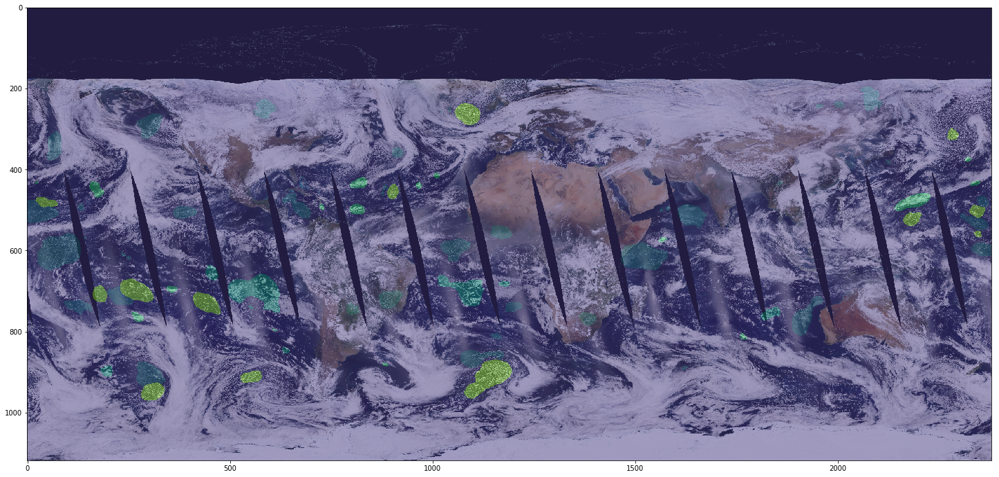

In [289]:
plot_mask_over_img(img, pred_mask, 0.2)

## Create a climatology

In [427]:
mask_fns = sorted(glob('/project/meteo/work/S.Rasp/cloud-classification/ml/world_mask*'))

In [428]:
len(mask_fns)

151

In [429]:
m = np.load(mask_fns[0])

In [430]:
m.shape

(5592, 11900)

In [432]:
mean_mask = np.zeros((4, *m.shape)); mean_mask.shape

(4, 5592, 11900)

In [433]:
for mfn in tqdm(mask_fns):
    m = np.load(mfn)
    for i in range(4):
        mean_mask[i] += m == i+1

In [434]:
mean_mask /= len(mask_fns)

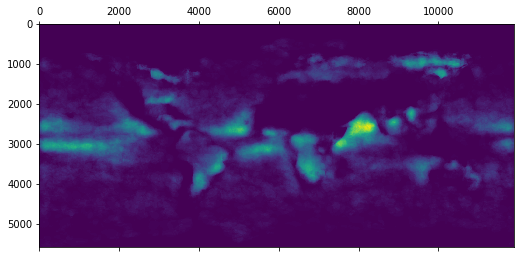

In [445]:
plt.matshow(mean_mask[0])

### Create a matching lat lon mask

In [ ]:
import cartopy.crs as ccrs

In [437]:
world_size

array([ 6000, 12000])

In [438]:
img.size

torch.Size([5592, 11900])

In [441]:
lons = np.linspace(-180,180,12000)
lats = np.linspace(90,-90,6000)

In [454]:
lons = lons[:11900]
lats = lats[-5592:]

In [456]:
max_lon, min_lat = lons[-1], lats[0]; max_lon, min_lat

(176.9997499791649, 77.75795965994334)

In [490]:
def plot_heatmap(mask, z=0.3, figsize=(10,10), save=None, title='', cblabel='',
                 levels=np.arange(0.05, 0.85, 0.05)):
    z = 0.3
    mask_re = zoom(mask, (z, z))
    nlat, nlon = mask_re.shape
    lons = np.linspace(-180,max_lon,nlon)
    lats = np.linspace(90,-min_lat,nlat)
    
    fig = plt.figure(figsize = (10, 10))
    ax = plt.axes(projection=ccrs.PlateCarree())
    plt.contourf(lons, lats, mask_re, transform=ccrs.PlateCarree(), cmap='gnuplot2_r', 
                 levels=levels, extend='both')
    ax.coastlines()
    plt.title(title)
    cb = plt.colorbar(orientation='horizontal', pad=0.01, extend='both', shrink=0.7)
    cb.ax.set_xlabel(cblabel)
    plt.tight_layout()

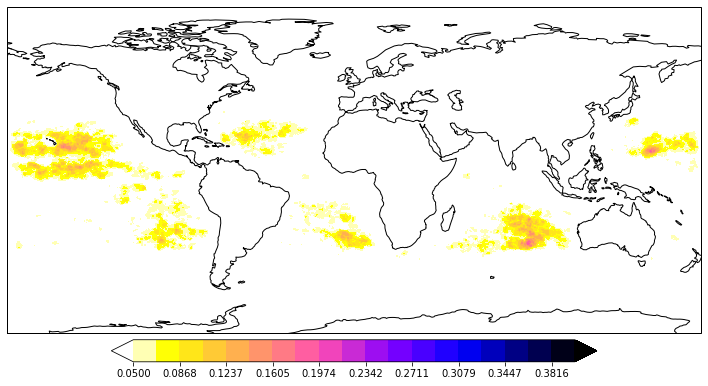

In [493]:
plot_heatmap(mean_mask[2], levels=np.linspace(0.05, 0.4, 20))

In [466]:
z = 0.3
mask_re = zoom(mean_mask[0], (z, z))

In [467]:
mask_re.shape

(1678, 3570)

In [468]:
nlat, nlon = mask_re.shape

In [469]:
lons = np.linspace(-180,max_lon,nlon)
lats = np.linspace(90,-min_lat,nlat)

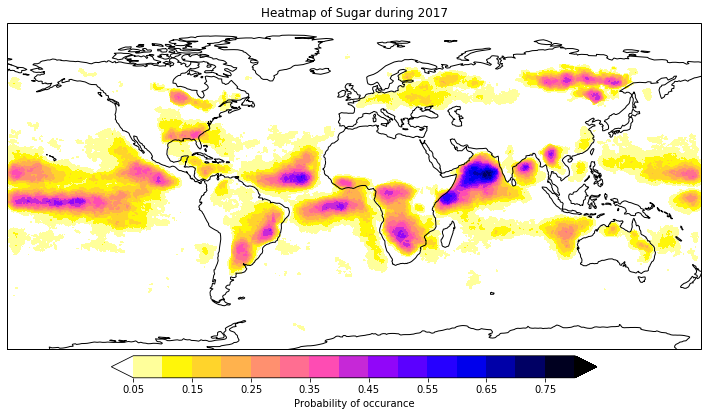

In [484]:
fig = plt.figure(figsize = (10, 10))
ax = plt.axes(projection=ccrs.PlateCarree())
plt.contourf(lons, lats, mask_re, transform=ccrs.PlateCarree(), cmap='gnuplot2_r', 
             levels=np.arange(0.05, 0.85, 0.05), extend='both')
ax.coastlines()
plt.title('Heatmap of Sugar during 2017')
cb = plt.colorbar(orientation='horizontal', pad=0.01, extend='both', shrink=0.7)
cb.ax.set_xlabel('Probability of occurance')
plt.tight_layout()

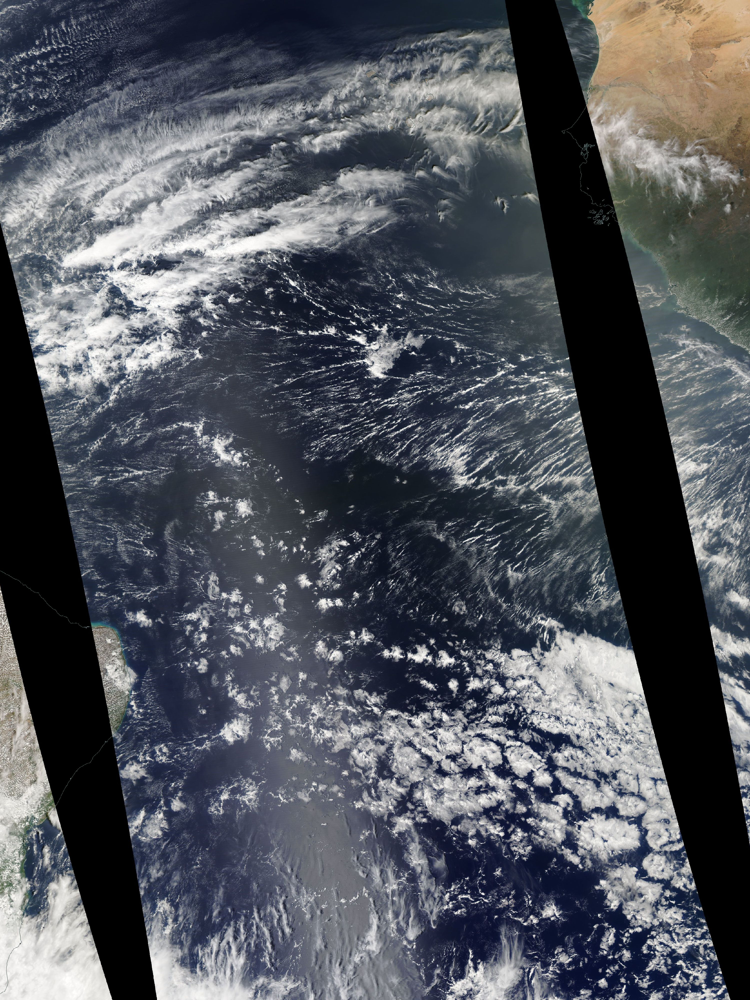

In [77]:
img

In [259]:
img.size

torch.Size([1334, 1334])

In [ ]:
world_fns[1:2]

In [230]:
# Create an empty segmentation mask
z = np.zeros((4000, 4000)).astype(np.int8)
m = PIL.Image.fromarray(z)
m.save('/project/meteo/work/S.Rasp/cloud-classification/masks/world/Aqua_CorrectedReflectance20171201_-40-0_-20-20.png')

In [158]:
!ls '/project/meteo/work/S.Rasp/cloud-classification/masks/world/Aqua_CorrectedReflectance20171201_-40-0_-20-20.png'

/project/meteo/work/S.Rasp/cloud-classification/masks/world/Aqua_CorrectedReflectance20171201_-40--10_-20-20.png


In [231]:
df = pd.DataFrame({
    'fn': ['Aqua_CorrectedReflectance20171201_-40-0_-20-20.jpeg']*10,
    'mask': ['/project/meteo/work/S.Rasp/cloud-classification/masks/world/Aqua_CorrectedReflectance20171201_-40-0_-20-20.png']*10
    
})

In [232]:
df

,fn,mask
0,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
1,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
2,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
3,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
4,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
5,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
6,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
7,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
8,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...
9,Aqua_CorrectedReflectance20171201_-40-0_-20-20...,/project/meteo/work/S.Rasp/cloud-classificatio...


In [233]:
src = SegmentationItemList.from_df(df, path='/project/meteo/work/S.Rasp/cloud-classification/world/')

In [234]:
src

SegmentationItemList (10 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world

In [235]:
#src = ImageItemList.from_folder('/project/meteo/work/S.Rasp/cloud-classification/world/*--10*')

In [236]:
src = src.random_split_by_pct(); src

ItemLists;

Train: SegmentationItemList (8 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Valid: SegmentationItemList (2 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Test: None

In [237]:
src = src.label_from_df('mask', classes=classes_bg); src

LabelLists;

Train: LabelList
y: SegmentationLabelList (8 items)
[ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world
x: SegmentationItemList (8 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Valid: LabelList
y: SegmentationLabelList (2 items)
[ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world
x: SegmentationItemList (2 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Test: None

In [238]:
src

LabelLists;

Train: LabelList
y: SegmentationLabelList (8 items)
[ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world
x: SegmentationItemList (8 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Valid: LabelList
y: SegmentationLabelList (2 items)
[ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world
x: SegmentationItemList (2 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Test: None

In [239]:
data.valid_ds[8][0].size

torch.Size([466, 700])

In [240]:
world_size = np.array((4000,4000)) // 3; world_size

array([1333, 1333])

In [241]:
world_data = src.transform(
    [RandTransform(tfm=TfmCrop (crop_pad), kwargs={}, p=1.0, resolved={}, do_run=True, is_random=True)]*2, 
    size = (1334,1334), tfm_y=True)

In [242]:
world_data = world_data.databunch(bs=1)

In [243]:
world_data = world_data.normalize(imagenet_stats)

In [244]:
world_data

ImageDataBunch;

Train: LabelList
y: SegmentationLabelList (8 items)
[ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world
x: SegmentationItemList (8 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Valid: LabelList
y: SegmentationLabelList (2 items)
[ImageSegment (1, 4000, 4000), ImageSegment (1, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world
x: SegmentationItemList (2 items)
[Image (3, 4000, 4000), Image (3, 4000, 4000)]...
Path: /project/meteo/work/S.Rasp/cloud-classification/world;

Test: None

In [260]:
img, mask = world_data.train_ds[1]

In [261]:
img.shape, mask.shape

(torch.Size([3, 1334, 1334]), torch.Size([1, 1334, 1334]))

In [262]:
img.data

tensor([[[0.5118, 0.4745, 0.4144,  ..., 0.6189, 0.7189, 0.7461],
         [0.3530, 0.3346, 0.3255,  ..., 0.6894, 0.7468, 0.7601],
         [0.3659, 0.3267, 0.3739,  ..., 0.7904, 0.7778, 0.7647],
         ...,
         [0.9248, 0.9190, 0.9194,  ..., 0.6387, 0.6710, 0.6843],
         [0.9288, 0.9224, 0.9229,  ..., 0.4994, 0.5277, 0.5288],
         [0.9314, 0.9248, 0.9255,  ..., 0.4823, 0.4582, 0.4402]],

        [[0.5392, 0.5006, 0.4379,  ..., 0.5418, 0.6418, 0.6637],
         [0.3791, 0.3586, 0.3491,  ..., 0.6092, 0.6671, 0.6758],
         [0.3947, 0.3546, 0.4014,  ..., 0.7063, 0.6937, 0.6771],
         ...,
         [0.9209, 0.9150, 0.9155,  ..., 0.6422, 0.6737, 0.6856],
         [0.9248, 0.9185, 0.9190,  ..., 0.5111, 0.5395, 0.5406],
         [0.9275, 0.9209, 0.9216,  ..., 0.4941, 0.4693, 0.4480]],

        [[0.5686, 0.5411, 0.4902,  ..., 0.3967, 0.5346, 0.5853],
         [0.4196, 0.4092, 0.4083,  ..., 0.4824, 0.5782, 0.6150],
         [0.4535, 0.4195, 0.4711,  ..., 0.6022, 0.6296, 0.

In [247]:
learn.data = world_data

In [253]:
pred = learn.predict(img)

RuntimeError: CUDA out of memory. Tried to allocate 109.00 MiB (GPU 0; 15.90 GiB total capacity; 14.88 GiB already allocated; 52.81 MiB free; 194.12 MiB cached)

In [249]:
pred[2].size()

torch.Size([5, 1334, 1334])

In [251]:
??get_pred

In [250]:
pred = get_pred(img)

RuntimeError: CUDA out of memory. Tried to allocate 672.12 MiB (GPU 0; 15.90 GiB total capacity; 13.28 GiB already allocated; 644.81 MiB free; 1.22 GiB cached)

ValueError: not enough values to unpack (expected 2, got 0)

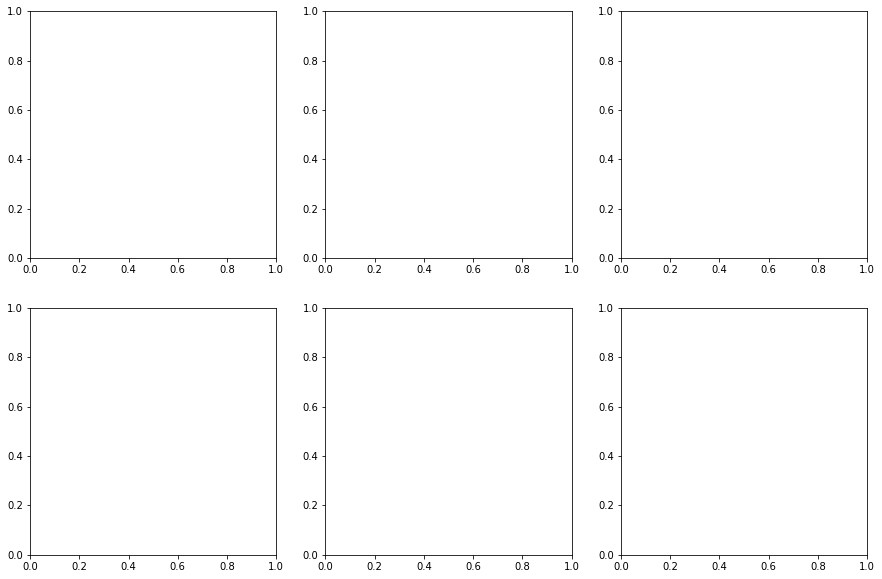

In [252]:
plot_probs(pred)

In [223]:
pred_mask = get_max_class(pred, 0.4, 15)

In [224]:
np.unique(pred_mask)

array([0, 1, 2])

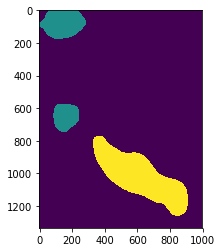

In [225]:
plt.imshow(pred_mask)

In [203]:
img.data.numpy()

array([[[0.474444, 0.41439 , 0.379302, 0.479517, ..., 0.816347, 0.827439, 0.825491, 0.833333],
        [0.334661, 0.325561, 0.360167, 0.416229, ..., 0.814382, 0.83047 , 0.827882, 0.826791],
        [0.326653, 0.373908, 0.504509, 0.469795, ..., 0.810471, 0.819614, 0.824847, 0.831387],
        [0.274653, 0.269329, 0.309289, 0.279163, ..., 0.820067, 0.82831 , 0.82874 , 0.832023],
        ...,
        [0.927255, 0.918078, 0.918049, 0.914563, ..., 0.      , 0.      , 0.      , 0.      ],
        [0.918959, 0.919388, 0.920712, 0.92982 , ..., 0.      , 0.      , 0.      , 0.      ],
        [0.922436, 0.92288 , 0.932035, 0.937234, ..., 0.      , 0.      , 0.      , 0.      ],
        [0.924836, 0.925494, 0.931381, 0.932655, ..., 0.      , 0.      , 0.      , 0.      ]],

       [[0.500585, 0.437919, 0.404798, 0.509595, ..., 0.686935, 0.674521, 0.67255 , 0.668627],
        [0.358629, 0.349094, 0.384139, 0.44369 , ..., 0.682354, 0.68104 , 0.674944, 0.669934],
        [0.354538, 0.401359, 0.5319

In [211]:
def plot_mask_over_img(img, mask):
    fig = plt.figure(figsize=(10,10))
    plt.imshow(np.rollaxis(img.data.numpy(), 0,3))
    plt.imshow(mask, alpha=0.2)

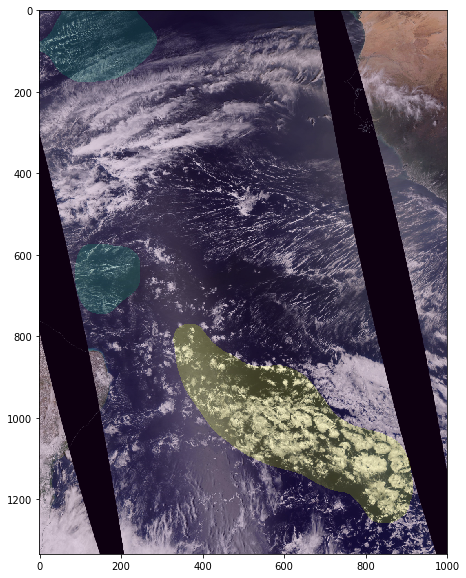

In [226]:
plot_mask_over_img(img, pred_mask)